# Fig2_ICIM_clustering

In [1]:
from __future__ import division
import sys
import random
import copy
import math
import json

import numpy as np
import pandas as pd
import scipy

%matplotlib inline
from matplotlib import pyplot as plt
import matplotlib as mpl

import seaborn as sns

sys.path.append("../resources/")
import sct
reload(sct)

sns.set_style("ticks")
sns.set_context("talk")

output_dir = "out/"
output_suffix = ""
output_formats = [".png", ".pdf"]

def save_figure(fig, name):
    for output_format in output_formats:
        fig.savefig(output_dir + "/" + name + output_suffix + output_format)
    return None

mpl.rc('savefig', dpi=300)

pd.options.mode.chained_assignment = None  # default='warn'

# Load data and libs

In [2]:
df_logCPM_all = pd.read_csv("../data/htseq_logCPM_hq.tab.gz", sep="\t", header=0, index_col=0) # CPM

df_libs = pd.read_csv("../data/libs_color3.csv", sep=",", header=0, index_col=0) # sample info

# select good ORNs

In [3]:
# Load names of high quality neurons (3/6 markers), cutoff 
names_hq_neurons = []
with open ("../data/names_hq_neurons.txt") as f:
    for line in f:
        names_hq_neurons.append(line.rstrip())

# Get names of ORNs
selector0 = (df_libs["label"] == "nSyb_48h_ORN_P0") 
selector1 = (df_libs["label"] == "nSyb_48h_ORN_P1")
selector2 = (df_libs["label"] == "nSyb_48h_ORN_P2")
selector3 = (df_libs["label"] == "nSyb_48h_ORN_P4")
names_ORN = [x for x in list(df_logCPM_all.columns) if ((x in df_libs.loc[selector0].index) 
                      or (x in df_libs.loc[selector1].index) 
                      or (x in df_libs.loc[selector2].index)
                      or (x in df_libs.loc[selector3].index))
                      and x in names_hq_neurons]
print "ORN", len(names_ORN)

# Get names new P4 85A10_ORNs
selector = (df_libs["label"] == "85A10_48h_ORN_P4") 
names_85A10_ORN = [x for x in list(df_logCPM_all.columns) if ((x in df_libs.loc[selector].index) and x in names_hq_neurons)]
print "New_85A10_ORN_P4", len(names_85A10_ORN)

# Get names AM29_ORNs
selector = (df_libs["label"] == "Am29_48h_ORN_P4") 
names_AM29_ORN = [x for x in list(df_logCPM_all.columns) if ((x in df_libs.loc[selector].index) and x in names_hq_neurons)]
print "AM29_ORN", len(names_AM29_ORN)

ORN 908
New_85A10_ORN_P4 63
AM29_ORN 45


In [5]:
# Filter for these cells
names_All_ORN = names_ORN + names_85A10_ORN +names_AM29_ORN

df_All_ORN = df_logCPM_all[list(names_All_ORN)]

df_AM29_ORN = df_logCPM_all[list(names_AM29_ORN)]
df_85A10_ORN = df_logCPM_all[list(names_85A10_ORN)]


print "ORN_All:", df_All_ORN.shape[1]
print "AM29_ORN:", df_AM29_ORN.shape[1]
print "85A10_ORN:", df_85A10_ORN.shape[1]

# Display number of cells of each genotype to confirm
#df_libs.loc[df.columns]["genotype"].value_counts()

ORN_All: 1016
AM29_ORN: 45
85A10_ORN: 63


# ICIM plot 

# Load ICIM genes and plot tSNE 

In [6]:
df = df_All_ORN
X = df_All_ORN
X.shape

(15908, 1016)

In [8]:
names_ORN_ICIM = []
with open("../data/ICIM_ORN_408_Genes.txt") as f:
    for line in f:
        names_ORN_ICIM.append(line.rstrip())
print "names_ORN_ICIM", len(names_ORN_ICIM)

names_ORN_ICIM 408


In [9]:
X.shape
Z = X.loc[names_ORN_ICIM]
Z.shape

(408, 1016)

In [10]:
df_libs = pd.read_csv("../data/libs_color3_PN_ORN.csv", sep=",", header=0, index_col=0) # sample info

[t-SNE] Computing 46 nearest neighbors...
[t-SNE] Computed conditional probabilities for sample 1000 / 1016
[t-SNE] Computed conditional probabilities for sample 1016 / 1016
[t-SNE] Mean sigma: 0.214192
[t-SNE] Iteration 25: error = 1.9991512, gradient norm = 0.0079487
[t-SNE] Iteration 50: error = 1.7835026, gradient norm = 0.0059780
[t-SNE] Iteration 75: error = 1.2907323, gradient norm = 0.0023776
[t-SNE] Iteration 100: error = 1.2215338, gradient norm = 0.0020045
[t-SNE] Error after 100 iterations with early exaggeration: 1.221534
[t-SNE] Iteration 125: error = 1.1194519, gradient norm = 0.0015110
[t-SNE] Iteration 150: error = 1.0901717, gradient norm = 0.0013704
[t-SNE] Iteration 175: error = 1.0831081, gradient norm = 0.0013386
[t-SNE] Iteration 200: error = 1.0812049, gradient norm = 0.0013296
[t-SNE] Iteration 225: error = 1.0806830, gradient norm = 0.0013255
[t-SNE] Iteration 250: error = 1.0805309, gradient norm = 0.0013245
[t-SNE] Iteration 275: error = 1.0804955, gradient 

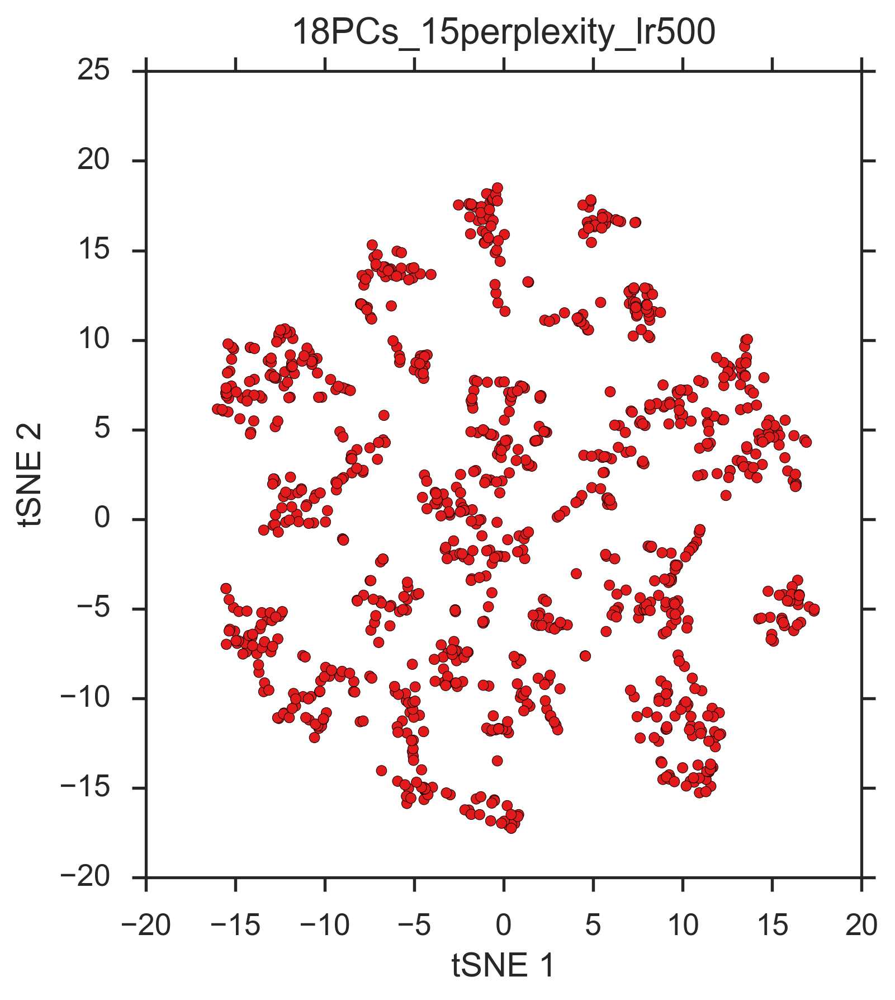

In [11]:
# Calculate TSNE
reload(sct)
from sklearn.manifold import TSNE

for i in range(18,19): # PC = i
    myPCA = sct.PCA(Z, X, i) # number of significant PCs was determined using shuffling performed elsewhere in parallel fashion
    myPCA.pca()
    Z_pca = pd.DataFrame(myPCA.X_pca.T)

    for j in range(15,16): # perplexity = j
        reload(sct)
        from sklearn.manifold import TSNE
        myTSNE = sct.TSNE(Z_pca, X, df_libs)
        
        myTSNE.calc_TSNE(perplexity=j, learning_rate=500)
        fig, ax = plt.subplots(1, 1, figsize=(6,6))
        myTSNE.plot(fig, ax, colorMode="genotype")
        ax.set_title(str(i)+"PCs_" + str(j) +"perplexity_lr500" , y=1.02)

# HDBSCAN to call clusters to decide cluster 12vs17 and 11vs16; manully curate the list by further dividing the clusters

Clusters 75


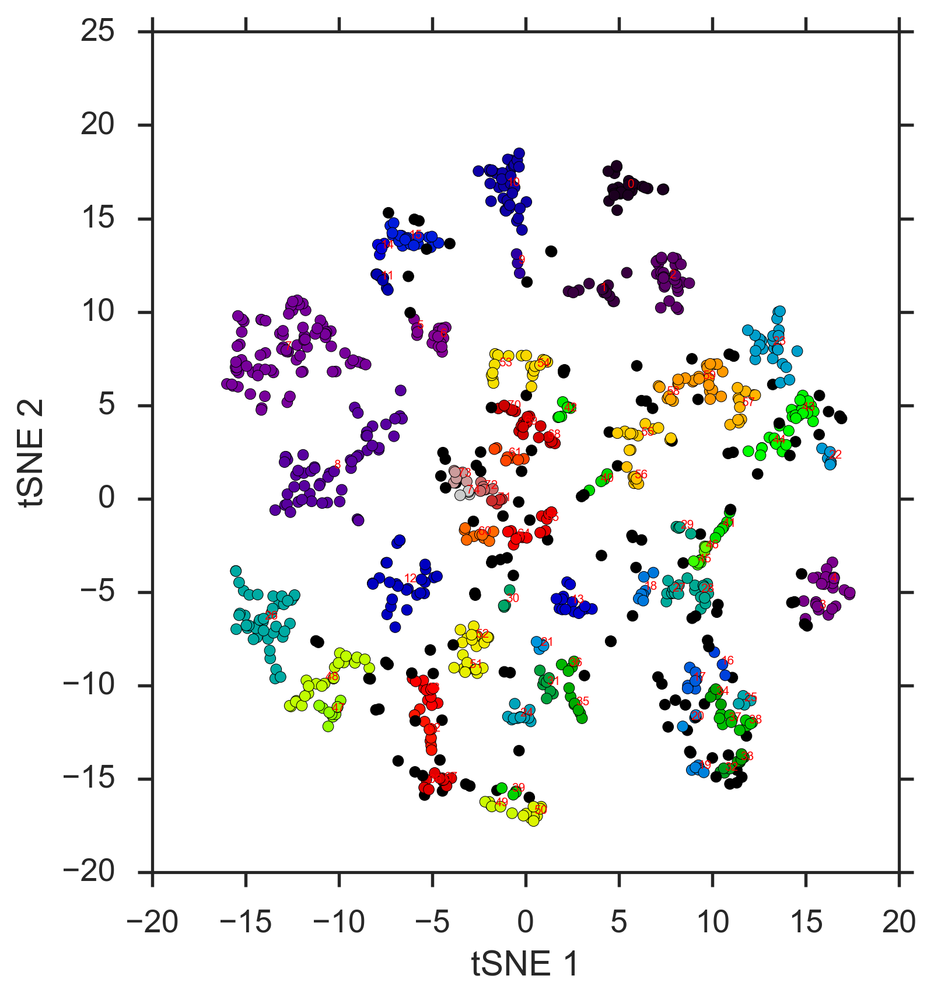

In [12]:
import hdbscan
#clusterer = hdbscan.HDBSCAN(min_cluster_size=6, min_samples=6).fit(myTSNE.X_tsne)
clusterer = hdbscan.HDBSCAN(min_cluster_size=3, min_samples=3).fit(myTSNE.X_tsne)


labels_HDBSCAN = clusterer.labels_
print "Clusters", max(labels_HDBSCAN)+1

# Plot TSNE colored by cluster assignment with labels
fig, ax = plt.subplots(1, 1, figsize=(6,6))
myTSNE.plot(fig, ax, colorMode="custom", colorBy=labels_HDBSCAN, cmap="nipy_spectral")
    
for label in pd.Series(labels_HDBSCAN).value_counts().index:
    if label == -1: continue
    x_bar = np.mean(myTSNE.X_tsne[labels_HDBSCAN == label, 0])
    y_bar = np.mean(myTSNE.X_tsne[labels_HDBSCAN == label, 1])
    ax.text(x_bar, y_bar, label, size=5, color = 'r')
    

In [11]:
# Display cluster cell counts
#print pd.Series(labels_HDBSCAN).value_counts()

In [13]:
# Thin and small basiconics
selector_Cluster12_DM3 = ((labels_HDBSCAN == 60) | (labels_HDBSCAN == 24) | (labels_HDBSCAN == 65))
names_Cluster12_DM3 = df.columns[selector_Cluster12_DM3]
print "names_Cluster12_DM3:", len(names_Cluster12_DM3)

selector_Cluster17_VM3 = ((labels_HDBSCAN == 71) | (labels_HDBSCAN == 72) | (labels_HDBSCAN == 73)| (labels_HDBSCAN == 74))
names_Cluster17_VM3 = df.columns[selector_Cluster17_VM3]
print "names_Cluster17_VM3:", len(names_Cluster17_VM3)


names_Cluster12_DM3: 27
names_Cluster17_VM3: 21


Clusters 157


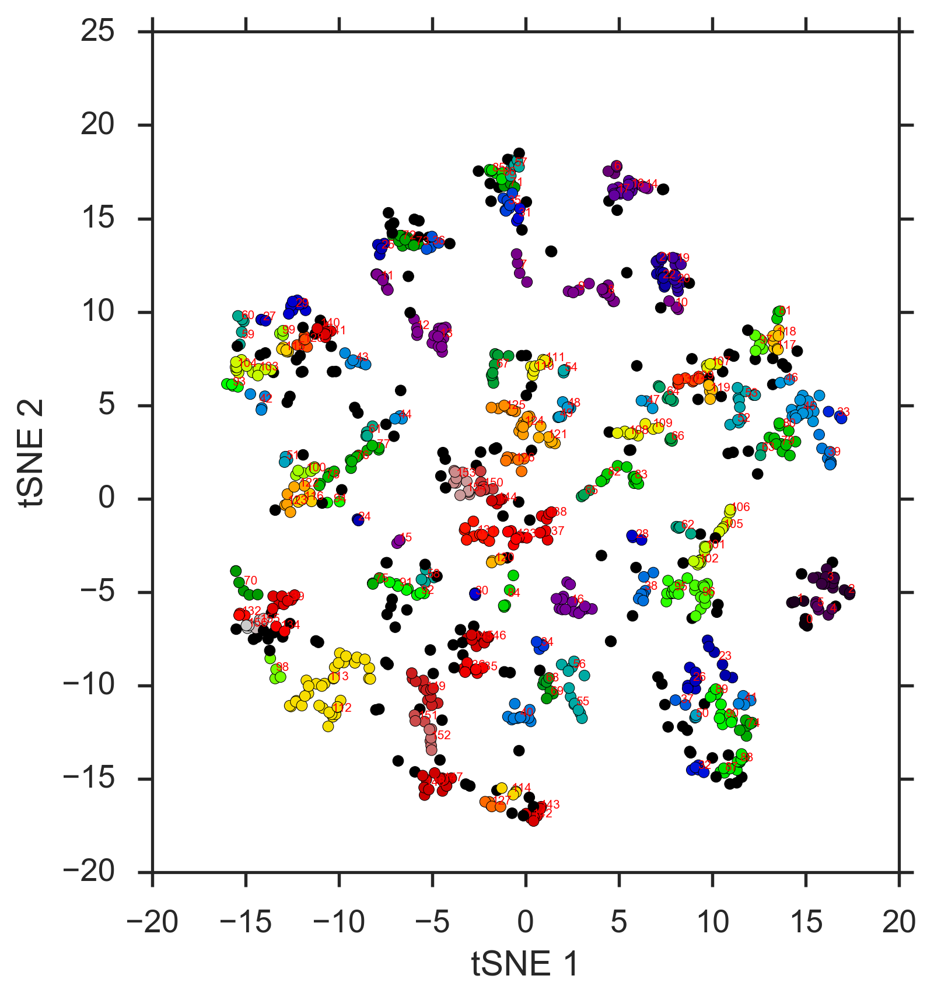

In [14]:
import hdbscan
#clusterer = hdbscan.HDBSCAN(min_cluster_size=6, min_samples=6).fit(myTSNE.X_tsne)
clusterer = hdbscan.HDBSCAN(min_cluster_size=2, min_samples=2).fit(myTSNE.X_tsne)


labels_HDBSCAN = clusterer.labels_
print "Clusters", max(labels_HDBSCAN)+1

# Plot TSNE colored by cluster assignment with labels
fig, ax = plt.subplots(1, 1, figsize=(6,6))
myTSNE.plot(fig, ax, colorMode="custom", colorBy=labels_HDBSCAN, cmap="nipy_spectral")
    
for label in pd.Series(labels_HDBSCAN).value_counts().index:
    if label == -1: continue
    x_bar = np.mean(myTSNE.X_tsne[labels_HDBSCAN == label, 0])
    y_bar = np.mean(myTSNE.X_tsne[labels_HDBSCAN == label, 1])
    ax.text(x_bar, y_bar, label, size=5, color = 'r')
    


In [15]:
selector_Cluster11_VL2a = ((labels_HDBSCAN == 44) | 
                           (labels_HDBSCAN == 61) | 
                           (labels_HDBSCAN == 76) | 
                           (labels_HDBSCAN == 77))
names_Cluster11_VL2a = df.columns[selector_Cluster11_VL2a]
print "names_Cluster11_VL2a:", len(names_Cluster11_VL2a)

selector_Cluster16_DP1l = ((labels_HDBSCAN == 51) | 
                           (labels_HDBSCAN == 78) | 
                           (labels_HDBSCAN == 94) | 
                           (labels_HDBSCAN == 100)|
                           (labels_HDBSCAN == 116)|
                           (labels_HDBSCAN == 122)| 
                           (labels_HDBSCAN == 123))
names_Cluster16_DP1l = df.columns[selector_Cluster16_DP1l]
print "names_Cluster16_DP1l:", len(names_Cluster16_DP1l)


names_Cluster11_VL2a: 16
names_Cluster16_DP1l: 28


# HDBSCAN to call clusters to decide other clusters

In [18]:
import hdbscan
#clusterer = hdbscan.HDBSCAN(min_cluster_size=6, min_samples=6).fit(myTSNE.X_tsne)
clusterer = hdbscan.HDBSCAN(min_cluster_size=6, min_samples=6).fit(myTSNE.X_tsne)


labels_HDBSCAN = clusterer.labels_
print "Clusters", max(labels_HDBSCAN)+1

Clusters 33


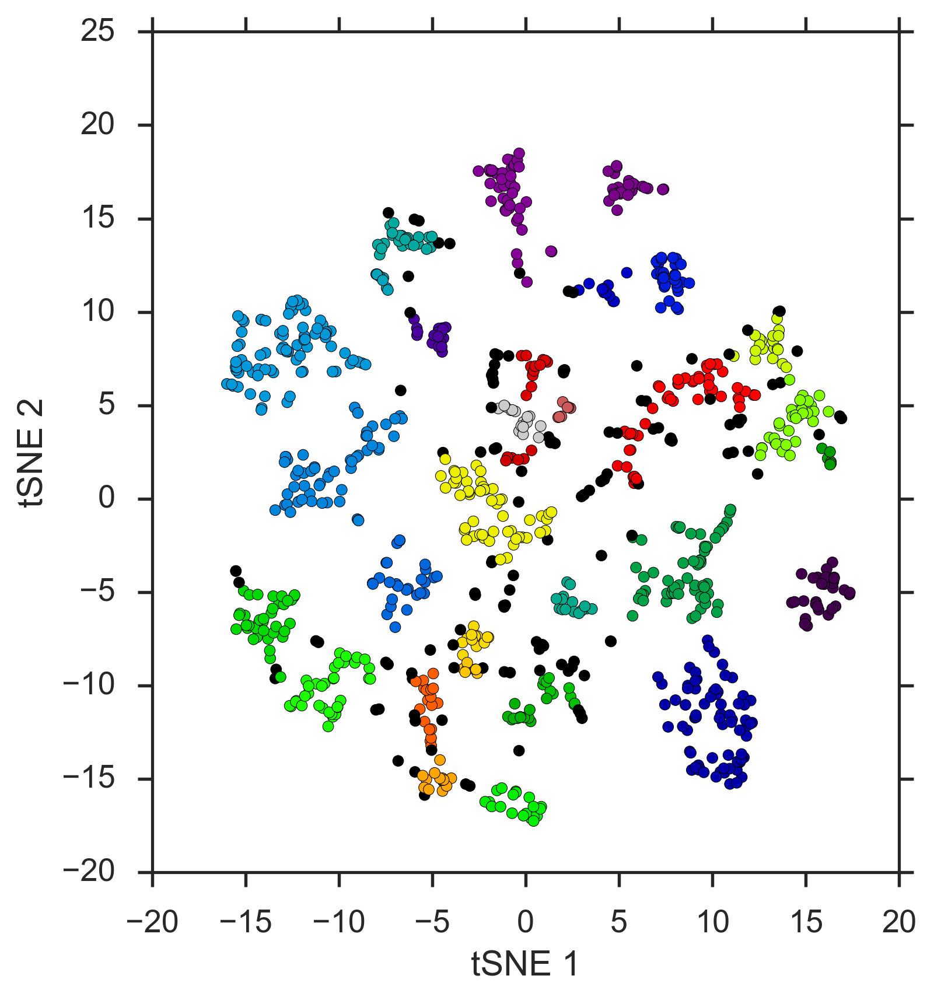

In [19]:
# Plot TSNE colored by cluster assignment with labels
fig, ax = plt.subplots(1, 1, figsize=(6,6))
myTSNE.plot(fig, ax, colorMode="custom", colorBy=labels_HDBSCAN, cmap="nipy_spectral")
    

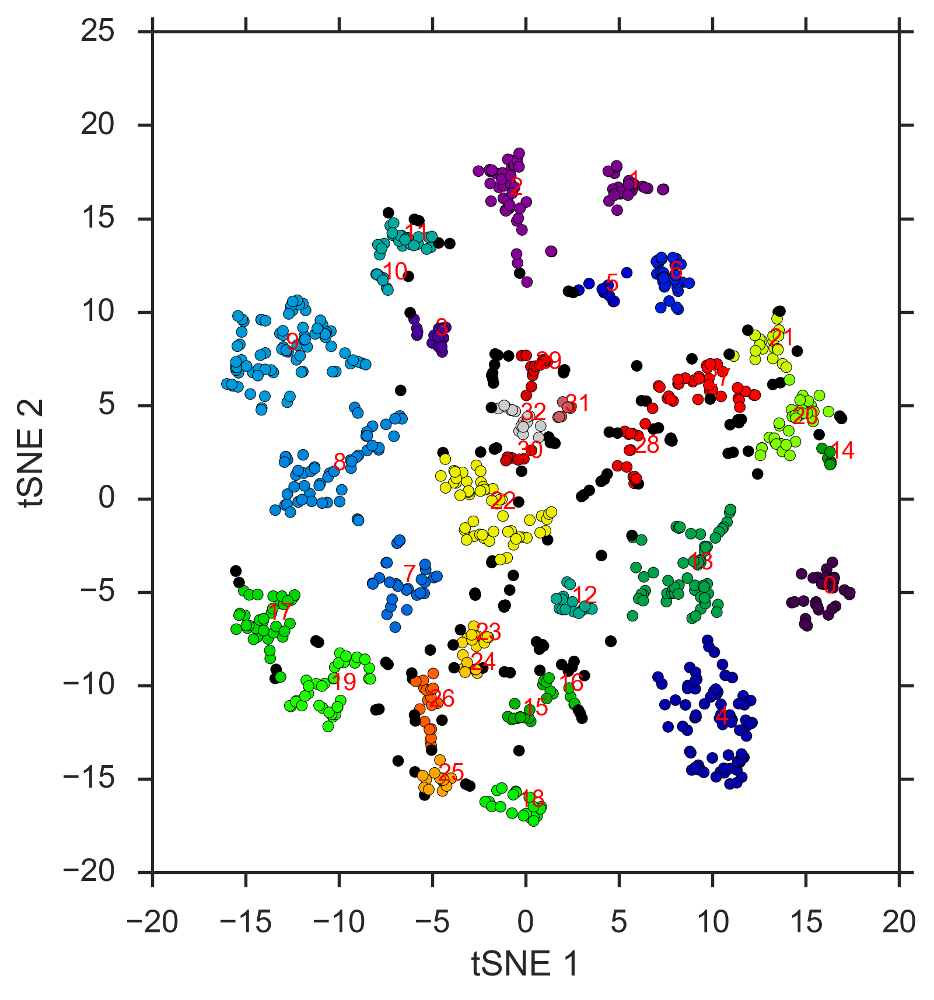

In [20]:
# Plot TSNE colored by cluster assignment with labels
fig, ax = plt.subplots(1, 1, figsize=(6,6))
myTSNE.plot(fig, ax, colorMode="custom", colorBy=labels_HDBSCAN, cmap="nipy_spectral")
    
for label in pd.Series(labels_HDBSCAN).value_counts().index:
    if label == -1: continue
    x_bar = np.mean(myTSNE.X_tsne[labels_HDBSCAN == label, 0])
    y_bar = np.mean(myTSNE.X_tsne[labels_HDBSCAN == label, 1])
    ax.text(x_bar, y_bar, label, size=10, color = 'r')
    

In [18]:
df_LB_Not_LB = pd.read_csv("../data_paper/lineage/df_DE_NEW_LB_Not_LB.csv", sep=",", header=0, index_col=0) # sample info

myGenes = df_LB_Not_LB.index[0:150]
myGenes

Index([u'CG43689', u'mamo', u'fabp', u'CG31676', u'CG30095', u'CG14079',
       u'CG40486', u'unpg', u'eyg', u'toe',
       ...
       u'CG42674', u'Cyt-c1', u'CG34353', u'Snmp1', u'SmF', u'Hsp67Ba',
       u'CG42540', u'CG33143', u'Lrpprc2', u'mew'],
      dtype='object', name=u'symbol', length=150)

/Users/hongjie/anaconda/lib/python2.7/site-packages/matplotlib/pyplot.py:516: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  max_open_warning, RuntimeWarning)


KeyboardInterrupt: 

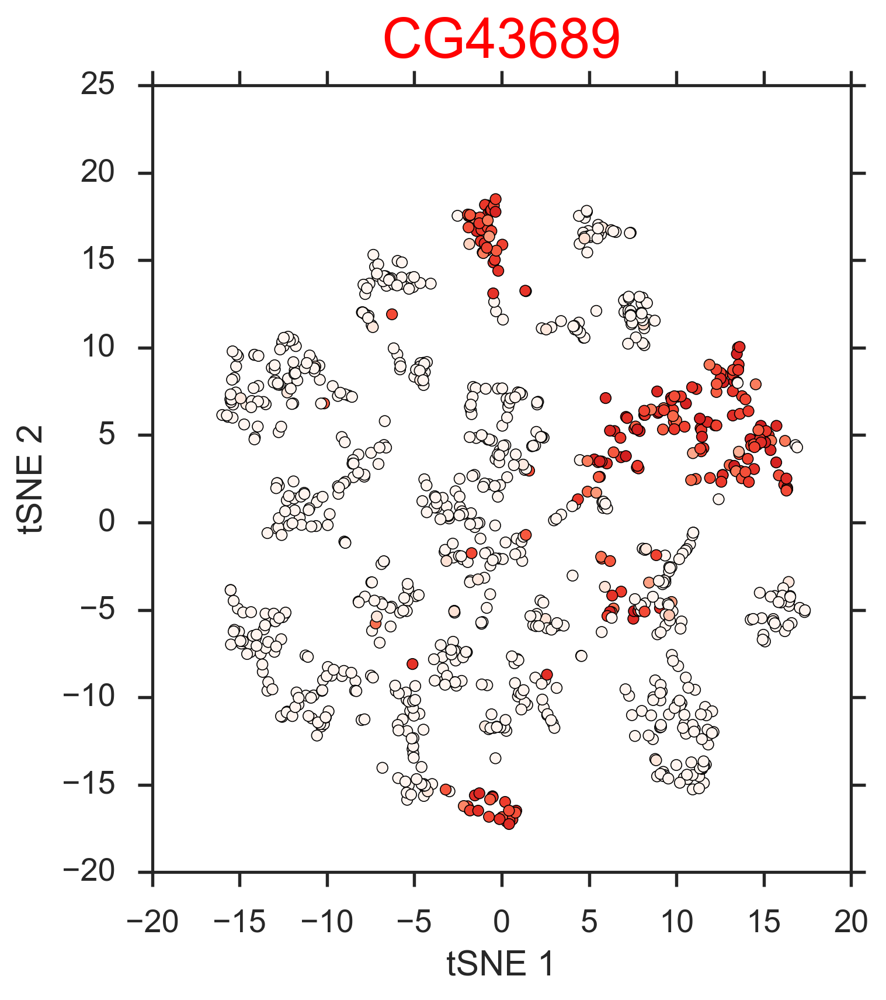

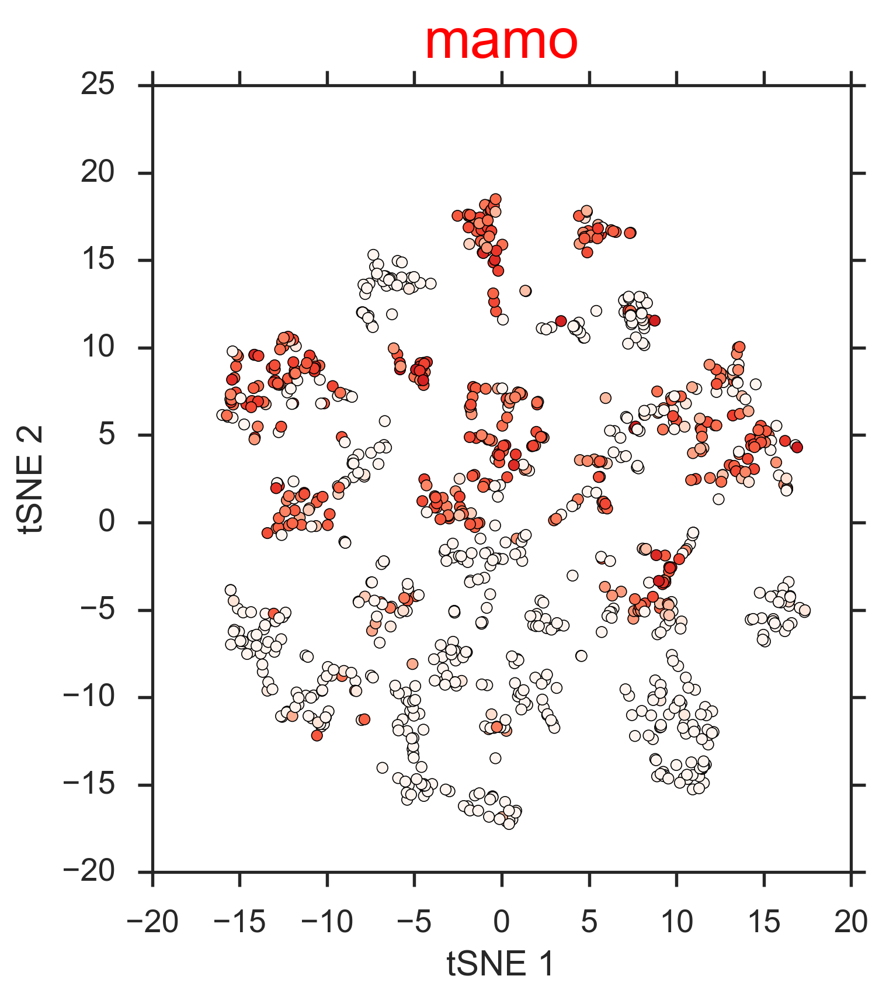

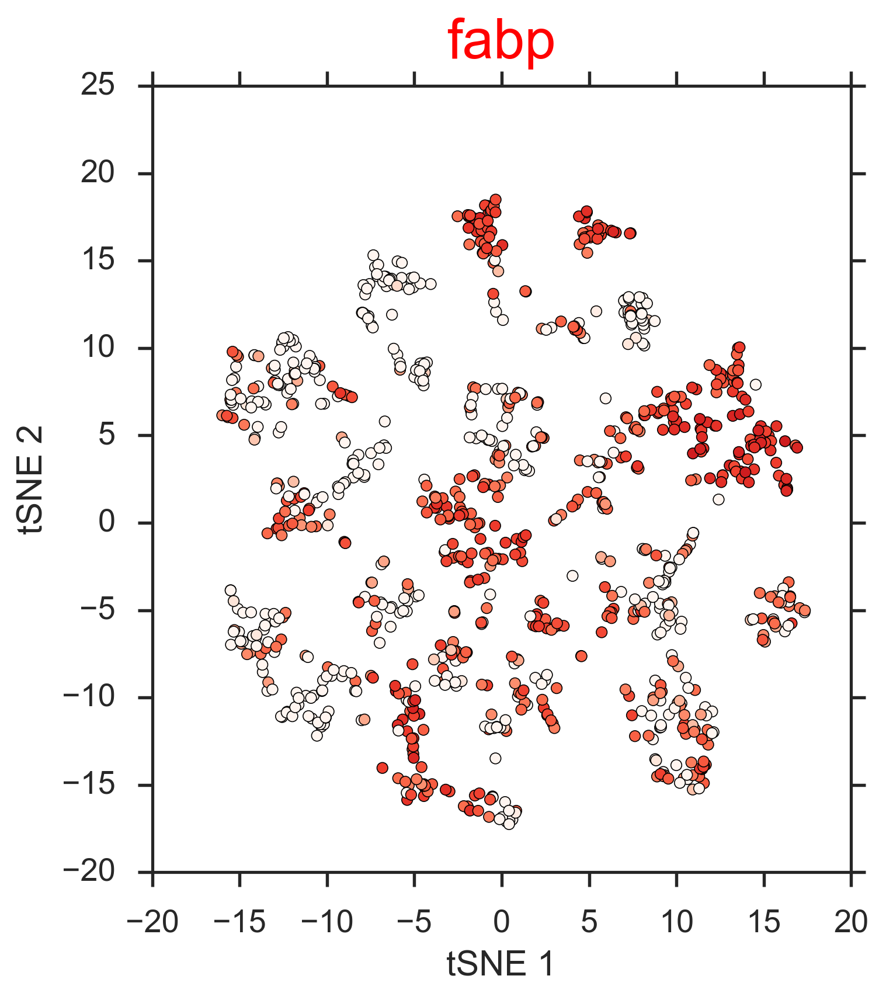

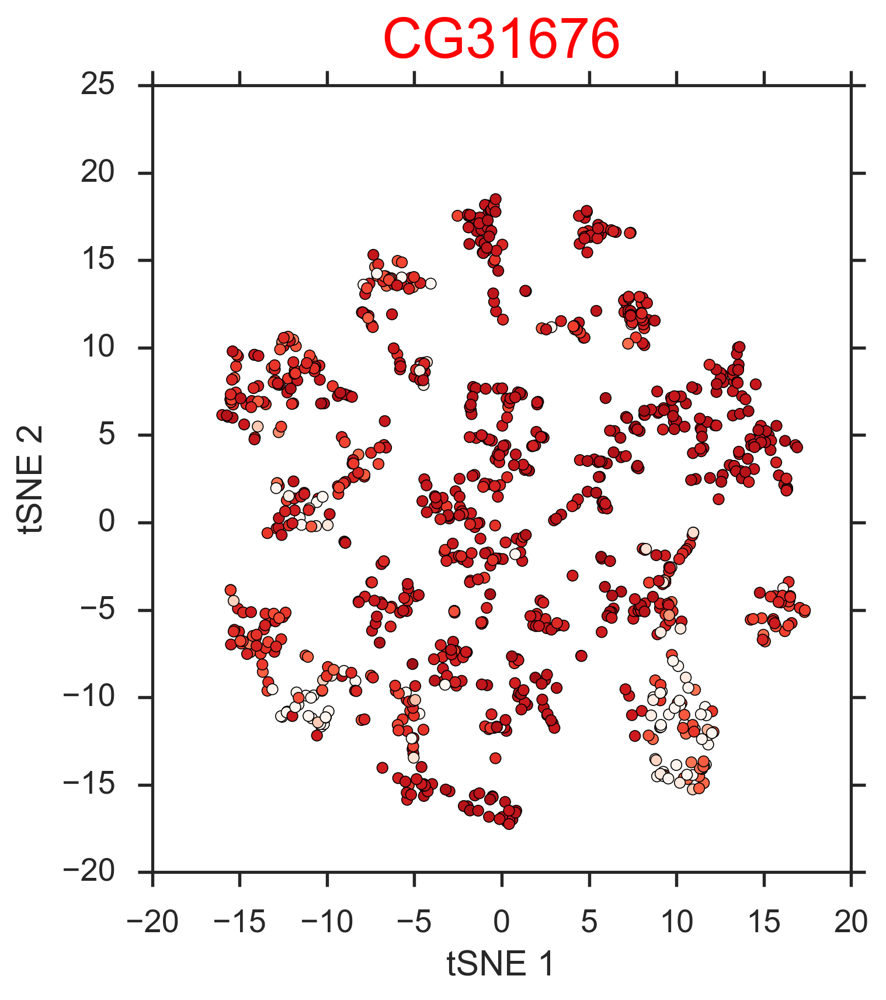

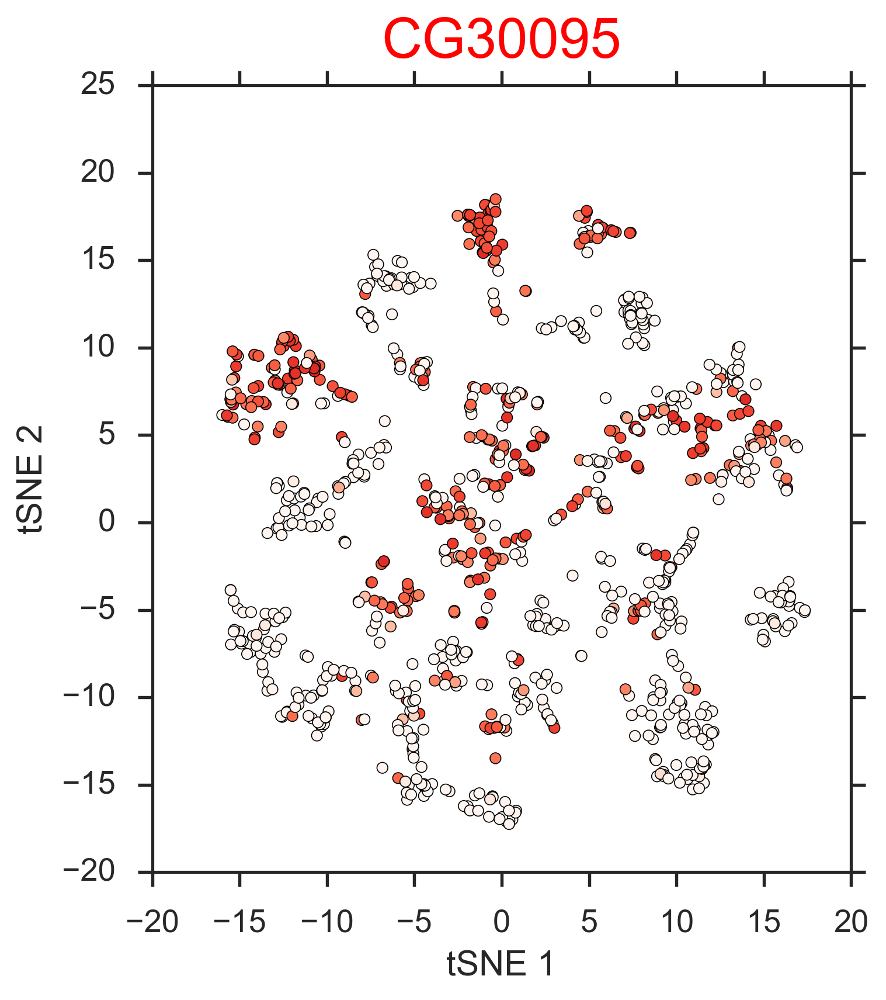

...

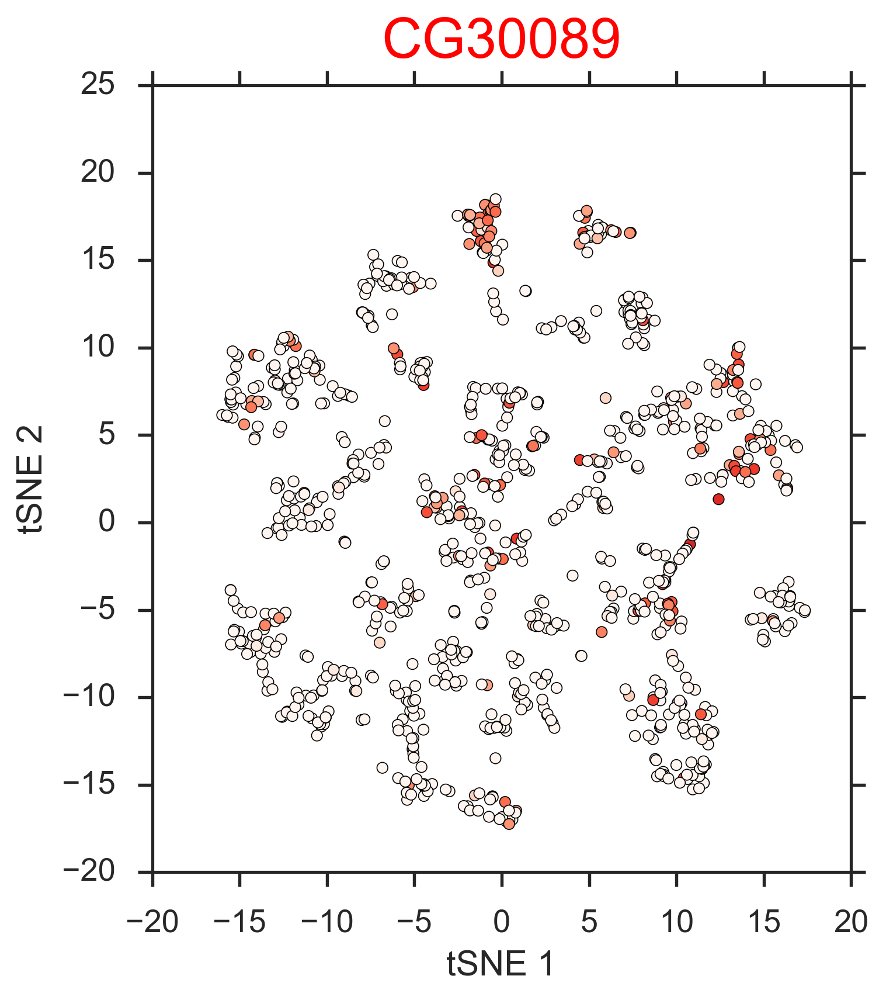

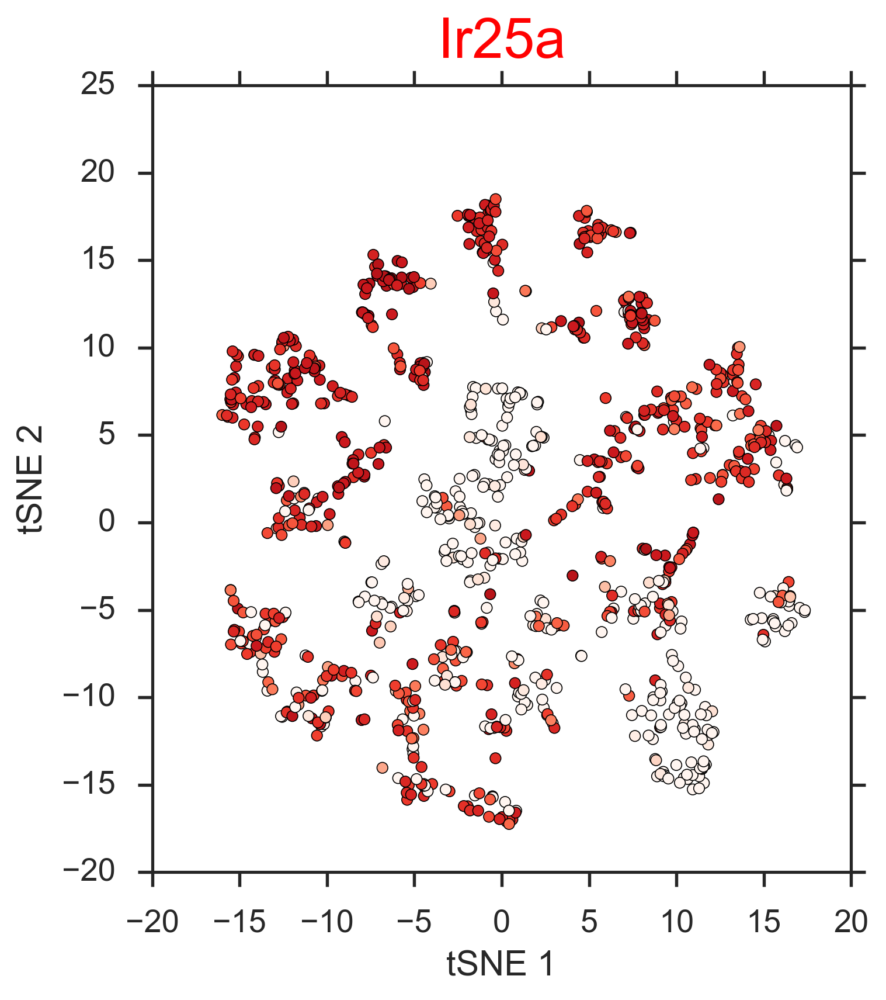

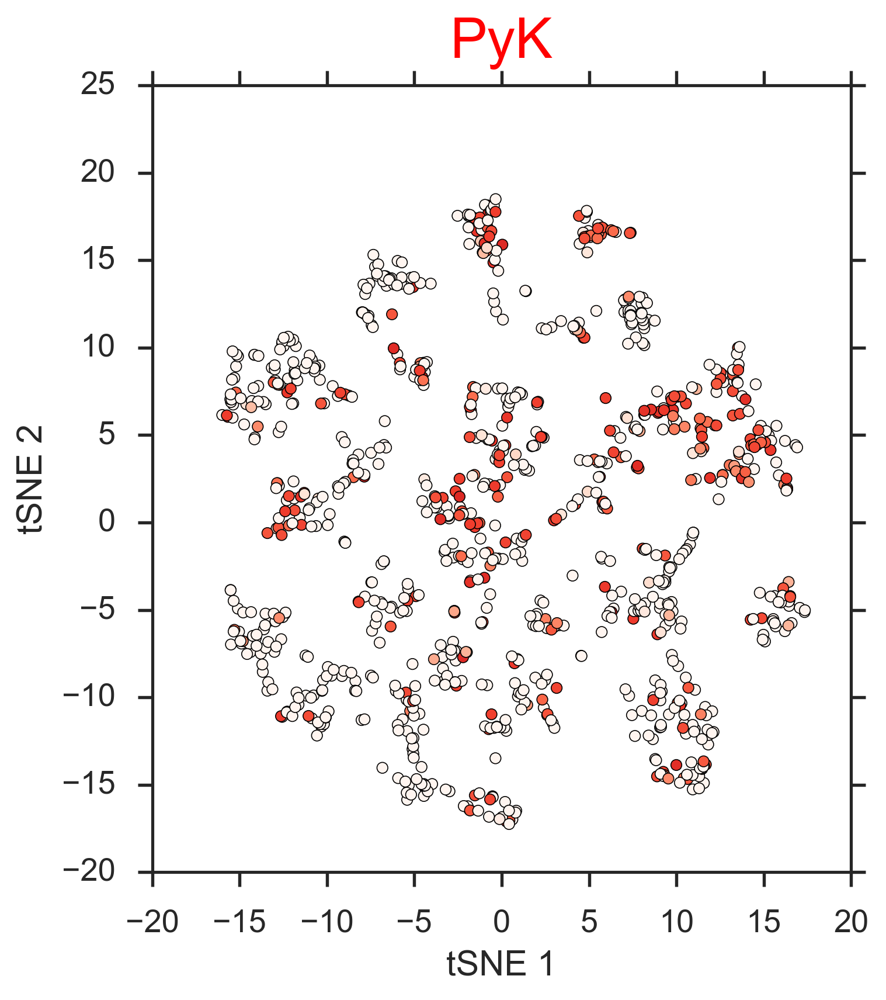

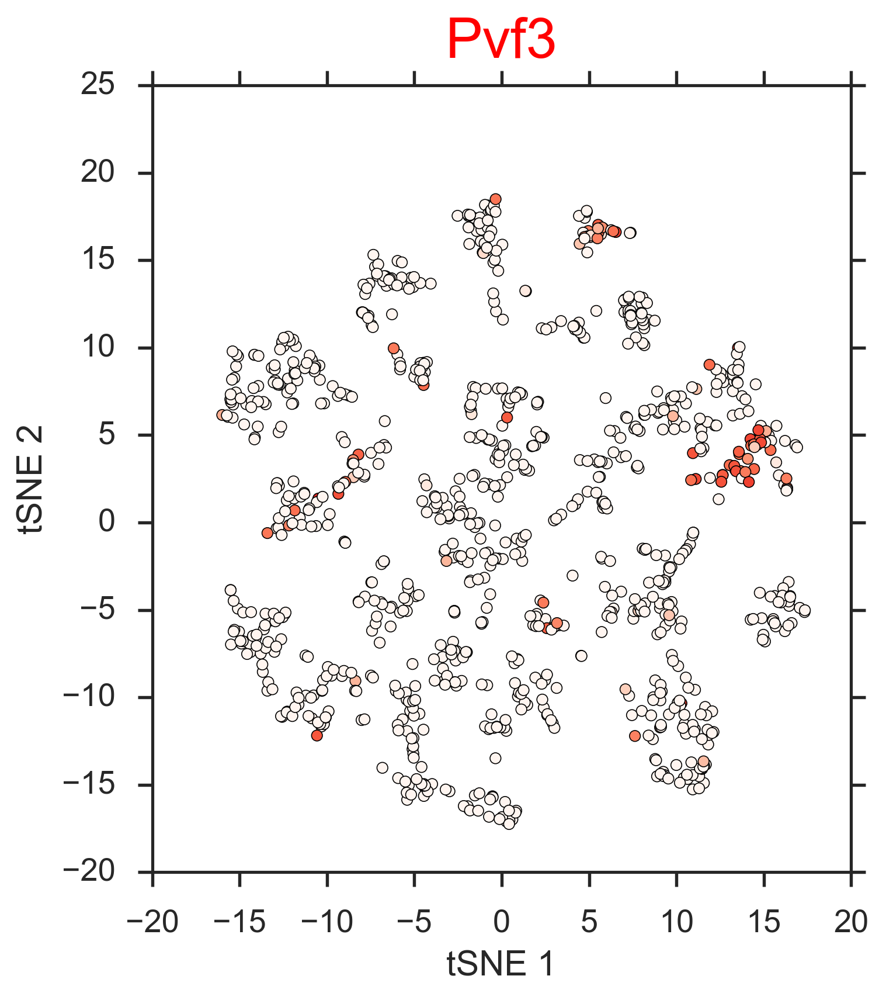

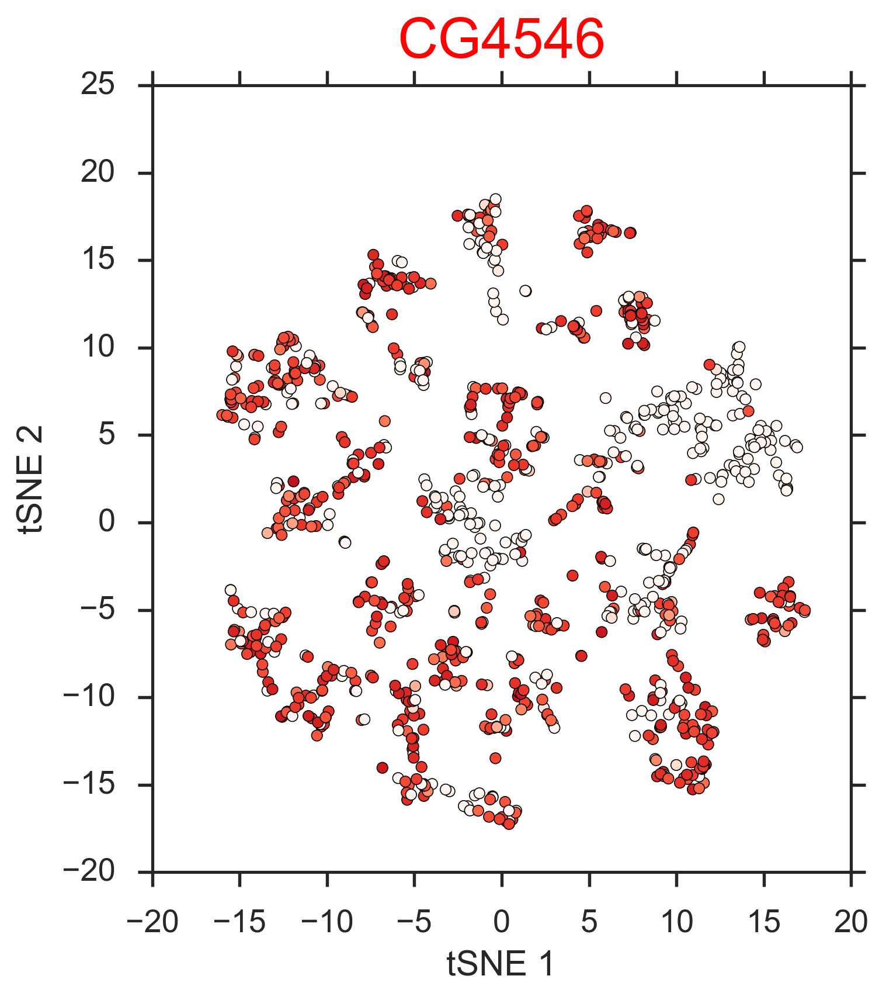

KeyboardInterrupt: 

In [18]:
a=1
for gene in myGenes:
    fig, ax = plt.subplots(1, 1, figsize=(6,6))
    sc = myTSNE.plot(fig, ax, colorBy=gene, cmap="Reds")
    ax.set_aspect("equal")
    ax.set_title(gene, color ="r", size= 23, y= 1.02)
    plt.tight_layout()
    fig.savefig("../HL_Figures_paper/Fig_4_lineage_LB/" + str(a) + "_LB_not_LB_" + gene +  ".pdf")
    a=a+1

In [21]:
# Display cluster cell counts
print pd.Series(labels_HDBSCAN).value_counts()

-1     128
 9      79
 4      74
 13     62
 8      55
 22     54
 2      42
 17     37
 19     36
 27     33
 20     33
 0      32
 6      30
 7      28
 1      26
 11     26
 18     23
 21     20
 3      19
 26     18
 32     16
 12     16
 28     16
 29     14
 23     14
 25     14
 15     13
 5      12
 16     10
 10      9
 31      7
 14      7
 24      7
 30      6
dtype: int64


# Extract cells corresponding to different ORN types, and 4 antennal groups

In [22]:
#selector = ((labels_HDBSCAN == 0) | (labels_HDBSCAN == 1) | (labels_HDBSCAN == 2))
df = df_All_ORN

selector_Cluster13_DM1 = (labels_HDBSCAN == 20)
names_Cluster13_DM1 = df.columns[selector_Cluster13_DM1]
print "names_Cluster13_DM1:", len(names_Cluster13_DM1)

selector_Cluster15_VA2 = (labels_HDBSCAN == 1)
names_Cluster15_VA2 = df.columns[selector_Cluster15_VA2]
print "names_Cluster15_VA2:", len(names_Cluster15_VA2)

selector_Cluster1_V = (labels_HDBSCAN == 2)
names_Cluster1_V = df.columns[selector_Cluster1_V]
print "names_Cluster1_V:", len(names_Cluster1_V)

selector_Cluster9_VM5vd = (labels_HDBSCAN == 9)
names_Cluster9_VM5vd = df.columns[selector_Cluster9_VM5vd]
print "names_Cluster9_VM5vd:", len(names_Cluster9_VM5vd)

selector_Cluster18_DM4 = (labels_HDBSCAN == 27)
names_Cluster18_DM4 = df.columns[selector_Cluster18_DM4]
print "names_Cluster18_DM4:", len(names_Cluster18_DM4)


names_LB_ORNs = list(list(names_Cluster13_DM1) + 
                     list(names_Cluster15_VA2) + 
                     list(names_Cluster1_V) +
                     list(names_Cluster18_DM4))

print "names_LB_ORNs:", len(names_LB_ORNs)

names_Cluster13_DM1: 33
names_Cluster15_VA2: 26
names_Cluster1_V: 42
names_Cluster9_VM5vd: 79
names_Cluster18_DM4: 33
names_LB_ORNs: 134


In [23]:
# Thin and small basiconics
print "names_Cluster12_DM3:", len(names_Cluster12_DM3)
print "names_Cluster17_VM3:", len(names_Cluster17_VM3)

selector_Cluster9_VM5v = (labels_HDBSCAN == 9)
names_Cluster9_VM5v = df.columns[selector_Cluster9_VM5v]
print "names_Cluster9_VM5v:", len(names_Cluster9_VM5v)


selector_Cluster2_DL4 = (labels_HDBSCAN == 26)
names_Cluster2_DL4 = df.columns[selector_Cluster2_DL4]
print "names_Cluster2_DL4:", len(names_Cluster2_DL4)

selector_Cluster3_DM6 = ((labels_HDBSCAN == 23) | (labels_HDBSCAN == 24))
names_Cluster3_DM6 = df.columns[selector_Cluster3_DM6]
print "names_Cluster3_DM6:", len(names_Cluster3_DM6)

names_SB_ORNs = list(list(names_Cluster12_DM3) + 
                     list(names_Cluster17_VM3) + 
                     list(names_Cluster2_DL4)  +
                     list(names_Cluster3_DM6))
print "names_SB_ORNs:", len(names_SB_ORNs)


names_Cluster12_DM3: 27
names_Cluster17_VM3: 21
names_Cluster9_VM5v: 79
names_Cluster2_DL4: 18
names_Cluster3_DM6: 21
names_SB_ORNs: 87


In [59]:
# Trichoids

selector_Cluster5_DA1 = (labels_HDBSCAN == 4)
names_Cluster5_DA1 = df.columns[selector_Cluster5_DA1]
print "names_Cluster5_DA1:", len(names_Cluster5_DA1)


selector_Cluster6_DC3 = (labels_HDBSCAN == 7)
names_Cluster6_DC3 = df.columns[selector_Cluster6_DC3]
print "names_Cluster6_DC3:", len(names_Cluster6_DC3)

selector_Cluster14_DA4l = (labels_HDBSCAN == 25)
names_Cluster14_DA4l = df.columns[selector_Cluster14_DA4l]
print "names_Cluster14_DA4l:", len(names_Cluster14_DA4l)

selector_Cluster7_DL3 = (labels_HDBSCAN == 19)
names_Cluster7_DL3 = df.columns[selector_Cluster7_DL3]
print "names_Cluster7_DL3:", len(names_Cluster7_DL3)

selector_Cluster8_VA1d = (labels_HDBSCAN == 17)
names_Cluster8_VA1d = df.columns[selector_Cluster8_VA1d]
print "names_Cluster8_VA1d:", len(names_Cluster8_VA1d)

selector_Cluster4_VA1v = (labels_HDBSCAN == 0)
names_Cluster4_VA1v = df.columns[selector_Cluster4_VA1v]
print "names_Cluster4_VA1v:", len(names_Cluster4_VA1v)


names_TC_ORNs = list(list(names_Cluster5_DA1)   + 
                     list(names_Cluster6_DC3)   + 
                     list(names_Cluster14_DA4l) +
                     list(names_Cluster7_DL3)   +
                     list(names_Cluster8_VA1d)  +
                     list(names_Cluster4_VA1v))

print "names_AT_ORNs:", len(names_TC_ORNs)


names_Cluster5_DA1: 74
names_Cluster6_DC3: 28
names_Cluster14_DA4l: 14
names_Cluster7_DL3: 36
names_Cluster8_VA1d: 37
names_Cluster4_VA1v: 32
names_AT_ORNs: 221


In [28]:
# Coeloconics

selector_Cluster10_VL1 = (labels_HDBSCAN == 6)
names_Cluster10_VL1 = df.columns[selector_Cluster10_VL1]
print "names_Cluster10_VL1:", len(names_Cluster10_VL1)

print "names_Cluster11_VL2a:", len(names_Cluster11_VL2a)
print "names_Cluster16_DP1l:", len(names_Cluster16_DP1l)

names_AC_ORNs = list(list(names_Cluster10_VL1)   + 
                     list(names_Cluster11_VL2a)   + 
                     list(names_Cluster16_DP1l))

print "names_AC_ORNs:", len(names_AC_ORNs)

names_Cluster10_VL1: 30
names_Cluster11_VL2a: 16
names_Cluster16_DP1l: 28
names_AC_ORNs: 74


# extract cell names for undecoded 2 clusters:

In [30]:
# Trichoids

selector_Cluster19 = (labels_HDBSCAN == 11)
names_Cluster19 = df.columns[selector_Cluster19]
print "names_Cluster19:", len(names_Cluster19)


selector_Cluster20 = (labels_HDBSCAN == 3)
names_Cluster20 = df.columns[selector_Cluster20]
print "names_Cluster20:", len(names_Cluster20)


names_Cluster19: 26
names_Cluster20: 19


In [31]:
print "LB ORNs:",len(names_LB_ORNs)
print "SB ORNs:",len(names_SB_ORNs)
print "TC ORNs:",len(names_TC_ORNs)
print "AC ORNs:",len(names_AC_ORNs)
print "total decoded cells", len(list(names_LB_ORNs)+list(names_SB_ORNs)+list(names_TC_ORNs)+list(names_AC_ORNs))

LB ORNs: 134
SB ORNs: 87
TC ORNs: 221
AC ORNs: 74
total decoded cells 516


# Save cell names as 4 types and 18 clusters

In [32]:
with open("../data/lineage/name_type1.txt", 'w') as out:
    for x in names_LB_ORNs:
        out.write(x + "\n")  

with open("../data/lineage/name_type2.txt", 'w') as out:
    for x in names_SB_ORNs:
        out.write(x + "\n")
    
with open("../data/lineage/name_type3.txt", 'w') as out:
    for x in names_TC_ORNs:
        out.write(x + "\n")
            
with open("../data/lineage/name_type4.txt", 'w') as out:
    for x in names_AC_ORNs:
        out.write(x + "\n")

In [58]:
name_cluster1 = names_Cluster1_V
name_cluster2 = names_Cluster2_DL4
name_cluster3 = names_Cluster3_DM6
name_cluster4 = names_Cluster4_VA1v
name_cluster5 = names_Cluster5_DA1
name_cluster6 = names_Cluster6_DC3
name_cluster7 = names_Cluster7_DL3
name_cluster8 = names_Cluster8_VA1d
name_cluster9 = names_Cluster9_VM5v
name_cluster10 = names_Cluster10_VL1
name_cluster11 = names_Cluster11_VL2a
name_cluster12 = names_Cluster12_DM3
name_cluster13 = names_Cluster13_DM1
name_cluster14 = names_Cluster14_DA4l
name_cluster15 = names_Cluster15_VA2
name_cluster16 = names_Cluster16_DP1l
name_cluster17 = names_Cluster17_VM3
name_cluster18 = names_Cluster18_DM4
name_cluster19 = names_Cluster19
name_cluster20 = names_Cluster20


In [37]:
# save name of all 20 clusters
with open("../data/lineage/name_cluster1.txt", 'w') as out:
    for x in name_cluster1:
        out.write(x + "\n")  

# Calculate the distance between each class

# Set a loop to compare between each type/group, ~12 hours

In [42]:
a = 0
for i in range(1,18):
    #print i
    names1 = []
    with open("../data/lineage/name_cluster" +str(i)+".txt") as f:
        for line in f:
            names1.append(line.rstrip())
    for j in range(i+1,19):
            names2 = []
            with open("../data/lineage/name_cluster" +str(j)+".txt") as f:
                for line in f:
                    names2.append(line.rstrip())
            #print len(names1), len(names2)
            #df_DE = pd.DataFrame()
            df_DE = sct.calc_DE_mannwhitneyu(df_4types, list(names1), list(names2))
            df_DE.to_csv("../data_paper/lineage/df_DE_cluster_" + str(i) +"_" +str(j) + ".csv")
            print "df_DE_type_" + str(i) +"_" +str(j) + " is done!"
            a += 1
print "all done!"
print "total pairs:",a

df_DE_type_1_2 is done!
df_DE_type_1_3 is done!
df_DE_type_1_4 is done!
df_DE_type_1_5 is done!
df_DE_type_1_6 is done!
df_DE_type_1_7 is done!
df_DE_type_1_8 is done!
df_DE_type_1_9 is done!
df_DE_type_1_10 is done!
df_DE_type_1_11 is done!
df_DE_type_1_12 is done!
df_DE_type_1_13 is done!
df_DE_type_1_14 is done!
df_DE_type_1_15 is done!
df_DE_type_1_16 is done!
df_DE_type_1_17 is done!
df_DE_type_1_18 is done!
df_DE_type_2_3 is done!
df_DE_type_2_4 is done!
df_DE_type_2_5 is done!
df_DE_type_2_6 is done!
df_DE_type_2_7 is done!
df_DE_type_2_8 is done!
df_DE_type_2_9 is done!
df_DE_type_2_10 is done!
df_DE_type_2_11 is done!
df_DE_type_2_12 is done!
df_DE_type_2_13 is done!
df_DE_type_2_14 is done!
df_DE_type_2_15 is done!
df_DE_type_2_16 is done!
df_DE_type_2_17 is done!
df_DE_type_2_18 is done!
df_DE_type_3_4 is done!
df_DE_type_3_5 is done!
df_DE_type_3_6 is done!
df_DE_type_3_7 is done!
df_DE_type_3_8 is done!
df_DE_type_3_9 is done!
df_DE_type_3_10 is done!
df_DE_type_3_11 is do

# Now, let us first find antennal type specific genes; Figure S4

In [60]:
names_decoded_ORNs = list(list(names_LB_ORNs) + list(names_SB_ORNs)+list(names_TC_ORNs) + list(names_AC_ORNs))
names_decoded_ORNs_add18 = list(list(names_LB_ORNs) + list(names_SB_ORNs)+list(names_TC_ORNs) + list(names_AC_ORNs)+list(names_Cluster18_DM4))
names_Not_LB_ORNs = list(list(names_SB_ORNs)+list(names_TC_ORNs) + list(names_AC_ORNs))
names_Not_SB_ORNs = list(list(names_LB_ORNs)+list(names_TC_ORNs) + list(names_AC_ORNs))
names_Not_TC_ORNs = list(list(names_LB_ORNs)+list(names_SB_ORNs) + list(names_AC_ORNs))
names_Not_AC_ORNs = list(list(names_LB_ORNs)+list(names_SB_ORNs) + list(names_TC_ORNs))



print "total decoded ORNs:", len(names_decoded_ORNs_add18)
print "None_LB ORNs:",len(names_Not_LB_ORNs)
print "None_SB ORNs:",len(names_Not_SB_ORNs)
print "None_TC ORNs:",len(names_Not_TC_ORNs)
print "None_AC ORNs:",len(names_Not_AC_ORNs)


total decoded ORNs: 549
None_LB ORNs: 382
None_SB ORNs: 429
None_TC ORNs: 295
None_AC ORNs: 442


In [61]:
df_4types = df[names_decoded_ORNs_add18]
df_4types.shape

(15908, 549)

In [62]:
df_DE_AC_Not_AC = sct.calc_DE_mannwhitneyu(df_4types, list(names_AC_ORNs), list(names_Not_AC_ORNs))

In [161]:
df_DE_TC_Not_TC = sct.calc_DE_mannwhitneyu(df_4types, list(names_TC_ORNs), list(names_Not_TC_ORNs))

In [166]:
df_DE_LB_Not_LB = sct.calc_DE_mannwhitneyu(df_4types, list(names_LB_ORNs), list(names_Not_LB_ORNs))

In [167]:
df_DE_SB_Not_SB = sct.calc_DE_mannwhitneyu(df_4types, list(names_SB_ORNs), list(names_Not_SB_ORNs))

In [163]:
df_DE_TC_Not_TC.to_csv("../data/lineage/df_DE_TC_Not_TC.csv")

In [164]:
df_DE_AC_Not_AC.to_csv("../data/lineage/df_DE_AC_Not_AC.csv")

In [168]:
df_DE_LB_Not_LB.to_csv("../data/lineage/df_DE_LB_Not_LB.csv")
df_DE_SB_Not_SB.to_csv("../data/lineage/df_DE_SB_Not_SB.csv")

In [172]:
print "ok"

ok


# Generate an average matrix for each cluster

In [66]:
df1= df[name_cluster1]
df2= df[name_cluster2]
df3= df[name_cluster3]
df4= df[name_cluster4]
df5= df[name_cluster5]
df6= df[name_cluster6]
df7= df[name_cluster7]
df8= df[name_cluster8]
df9= df[name_cluster9]
df10= df[name_cluster10]
df11= df[name_cluster11]
df12= df[name_cluster12]
df13= df[name_cluster13]
df14= df[name_cluster14]
df15= df[name_cluster15]
df16= df[name_cluster16]
df17= df[name_cluster17]
df18= df[name_cluster18]
df19= df[name_cluster19]
df20= df[name_cluster20]



print df1.shape
print df2.shape
print df3.shape


(15908, 42)
(15908, 18)
(15908, 21)


In [67]:
df1['mean_1'] = df1.mean(numeric_only=True, axis=1)
df1['mean_2'] = df2.mean(numeric_only=True, axis=1)
df1['mean_3'] = df3.mean(numeric_only=True, axis=1)
df1['mean_4'] = df4.mean(numeric_only=True, axis=1)
df1['mean_5'] = df5.mean(numeric_only=True, axis=1)
df1['mean_6'] = df6.mean(numeric_only=True, axis=1)
df1['mean_7'] = df7.mean(numeric_only=True, axis=1)
df1['mean_8'] = df8.mean(numeric_only=True, axis=1)
df1['mean_9'] = df9.mean(numeric_only=True, axis=1)
df1['mean_10'] = df10.mean(numeric_only=True, axis=1)
df1['mean_11'] = df11.mean(numeric_only=True, axis=1)
df1['mean_12'] = df12.mean(numeric_only=True, axis=1)
df1['mean_13'] = df13.mean(numeric_only=True, axis=1)
df1['mean_14'] = df14.mean(numeric_only=True, axis=1)
df1['mean_15'] = df15.mean(numeric_only=True, axis=1)
df1['mean_16'] = df16.mean(numeric_only=True, axis=1)
df1['mean_17'] = df17.mean(numeric_only=True, axis=1)
df1['mean_18'] = df18.mean(numeric_only=True, axis=1)
df1['mean_19'] = df19.mean(numeric_only=True, axis=1)
df1['mean_20'] = df20.mean(numeric_only=True, axis=1)


In [57]:
df1.to_csv("../data_paper/df_test_1.csv")
#df2.to_csv("../data_paper/df_test_2.csv")
#df3.to_csv("../data_paper/df_test_3.csv")

In [68]:
df_mean = df1.iloc[:, 42:65]

In [69]:
df_mean

,mean_1,mean_2,mean_3,mean_4,mean_5,mean_6,mean_7,mean_8,mean_9,mean_10,mean_11,mean_12,mean_13,mean_14,mean_15,mean_16,mean_17,mean_18,mean_19,mean_20
symbol,,,,,,,,,,,,,,,,,,,,
7SLRNA:CR32864,0.000000,0.000000,0.063271,0.046175,0.015485,0.038347,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.084417,0.000000,0.048127,0.038312,0.000000,0.000000,0.000000
a,0.262626,0.000000,0.000000,0.136879,0.107948,0.548631,0.140412,0.258210,0.187075,0.000000,0.681388,0.000000,0.196505,0.380980,0.497789,0.263068,0.000000,0.158884,0.000000,0.334057
abd-A,0.000000,0.000000,0.000000,0.000000,0.012279,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.032603,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
Abd-B,0.306753,0.150433,0.468056,0.033821,0.107547,0.000000,0.211293,0.000000,0.120108,0.223389,0.610176,0.000000,0.000000,0.462670,0.159166,0.042038,0.000000,0.133935,0.276234,0.000000
Abl,1.649792,2.051663,1.152831,1.797318,3.114223,2.330371,2.047482,1.859285,1.987052,0.988755,2.274229,2.383858,2.803788,3.486319,0.842894,1.171993,1.805730,1.561291,0.959830,1.354316
abo,0.163167,0.444256,0.000000,0.820264,0.607693,0.767146,0.127458,0.667880,0.861227,0.520769,0.000000,0.368181,0.787023,1.377705,0.205445,0.618242,1.258416,0.395756,0.000000,0.474511
ac,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.205272,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
Ace,4.711428,0.000000,0.822351,4.026381,2.953576,1.642298,2.996687,1.462586,2.219867,3.684032,2.256671,0.701206,2.822952,2.851417,4.596265,5.637806,3.528982,2.688341,1.359317,0.695372
acj6,7.414510,7.101573,8.380385,6.612561,6.544115,7.415548,5.087400,5.956093,7.427867,5.908079,7.111526,6.126970,8.444588,7.558198,7.620100,6.062942,8.637027,7.426103,6.546882,6.721467


In [70]:
df_mean_decoded = df1.iloc[:, 42:60]

In [71]:
df_mean_decoded

,mean_1,mean_2,mean_3,mean_4,mean_5,mean_6,mean_7,mean_8,mean_9,mean_10,mean_11,mean_12,mean_13,mean_14,mean_15,mean_16,mean_17,mean_18
symbol,,,,,,,,,,,,,,,,,,
7SLRNA:CR32864,0.000000,0.000000,0.063271,0.046175,0.015485,0.038347,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.084417,0.000000,0.048127,0.038312,0.000000
a,0.262626,0.000000,0.000000,0.136879,0.107948,0.548631,0.140412,0.258210,0.187075,0.000000,0.681388,0.000000,0.196505,0.380980,0.497789,0.263068,0.000000,0.158884
abd-A,0.000000,0.000000,0.000000,0.000000,0.012279,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.032603,0.000000,0.000000,0.000000,0.000000,0.000000
Abd-B,0.306753,0.150433,0.468056,0.033821,0.107547,0.000000,0.211293,0.000000,0.120108,0.223389,0.610176,0.000000,0.000000,0.462670,0.159166,0.042038,0.000000,0.133935
Abl,1.649792,2.051663,1.152831,1.797318,3.114223,2.330371,2.047482,1.859285,1.987052,0.988755,2.274229,2.383858,2.803788,3.486319,0.842894,1.171993,1.805730,1.561291
abo,0.163167,0.444256,0.000000,0.820264,0.607693,0.767146,0.127458,0.667880,0.861227,0.520769,0.000000,0.368181,0.787023,1.377705,0.205445,0.618242,1.258416,0.395756
ac,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.205272,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
Ace,4.711428,0.000000,0.822351,4.026381,2.953576,1.642298,2.996687,1.462586,2.219867,3.684032,2.256671,0.701206,2.822952,2.851417,4.596265,5.637806,3.528982,2.688341
acj6,7.414510,7.101573,8.380385,6.612561,6.544115,7.415548,5.087400,5.956093,7.427867,5.908079,7.111526,6.126970,8.444588,7.558198,7.620100,6.062942,8.637027,7.426103


In [72]:
# Through all comparison between each of two clusters, we get sets of differentially expressed genes. We next removed duplicates.

DE_genes_combined =[]
P_threshold = 0.05
print "P =", P_threshold

for i in range(1,18):
    for j in range(i+1,19):
        #print i, j
        df_DE_cluster = pd.read_csv("../data/lineage/df_DE_cluster_" + str(i) +"_" +str(j) + ".csv", sep=",", header=0, index_col=0) # sample info
        DE_genes = df_DE_cluster[df_DE_cluster["pvalue_adj"]< P_threshold].index
        print "DE_genes_type_"+ str(i) +"_" +str(j),len(DE_genes),len(DE_genes_combined)
        DE_genes_combined = list(DE_genes_combined) + list(DE_genes)

DE_genes_combined_remove_dup = list(set(DE_genes_combined))
print "after romoving duplicates", len(DE_genes_combined_remove_dup),len(DE_genes_combined)
        

P = 0.05
DE_genes_type_1_2 65 0
DE_genes_type_1_3 78 65
DE_genes_type_1_4 103 143
DE_genes_type_1_5 173 246
DE_genes_type_1_6 79 419
DE_genes_type_1_7 157 498
DE_genes_type_1_8 111 655
DE_genes_type_1_9 123 766
DE_genes_type_1_10 79 889
DE_genes_type_1_11 33 968
DE_genes_type_1_12 52 1001
DE_genes_type_1_13 79 1053
DE_genes_type_1_14 49 1132
DE_genes_type_1_15 62 1181
DE_genes_type_1_16 37 1243
DE_genes_type_1_17 62 1280
DE_genes_type_1_18 67 1342
DE_genes_type_2_3 5 1409
DE_genes_type_2_4 30 1414
DE_genes_type_2_5 45 1444
DE_genes_type_2_6 14 1489
DE_genes_type_2_7 12 1503
DE_genes_type_2_8 23 1515
DE_genes_type_2_9 52 1538
DE_genes_type_2_10 42 1590
DE_genes_type_2_11 15 1632
DE_genes_type_2_12 12 1647
DE_genes_type_2_13 48 1659
DE_genes_type_2_14 2 1707
DE_genes_type_2_15 32 1709
DE_genes_type_2_16 29 1741
DE_genes_type_2_17 15 1770
DE_genes_type_2_18 32 1785
DE_genes_type_3_4 38 1817
DE_genes_type_3_5 64 1855
DE_genes_type_3_6 20 1919
DE_genes_type_3_7 47 1939
DE_genes_type_3_8 44 

In [73]:
df_libs = pd.read_csv("../data/libs_cluster_mean.csv", sep=",", header=0, index_col=0) # sample info

In [75]:
# Since cluster #9 was mapped to two ORN types, we removed it for this analysis

#df_mean_decoded_new = df1.iloc[:, 42:60]
df_mean_decoded_new_no9 = pd.concat([df1.iloc[:, 42:50], df1.iloc[:, 51:60]],axis=1)
#df_mean_decoded_new_no9_19 = pd.concat([df1.iloc[:, 42:50], df1.iloc[:, 51:61]],axis=1)
#df_mean_decoded_new_no9_20 = pd.concat([df1.iloc[:, 42:50], df1.iloc[:, 51:60], df1.iloc[:, 61:62]],axis=1)
df_mean_decoded_new_no9_19_20 = pd.concat([df1.iloc[:, 42:50], df1.iloc[:, 51:62]],axis=1)

df_mean_decoded_new_no9

,mean_1,mean_2,mean_3,mean_4,mean_5,mean_6,mean_7,mean_8,mean_10,mean_11,mean_12,mean_13,mean_14,mean_15,mean_16,mean_17,mean_18
symbol,,,,,,,,,,,,,,,,,
7SLRNA:CR32864,0.000000,0.000000,0.063271,0.046175,0.015485,0.038347,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.084417,0.000000,0.048127,0.038312,0.000000
a,0.262626,0.000000,0.000000,0.136879,0.107948,0.548631,0.140412,0.258210,0.000000,0.681388,0.000000,0.196505,0.380980,0.497789,0.263068,0.000000,0.158884
abd-A,0.000000,0.000000,0.000000,0.000000,0.012279,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.032603,0.000000,0.000000,0.000000,0.000000,0.000000
Abd-B,0.306753,0.150433,0.468056,0.033821,0.107547,0.000000,0.211293,0.000000,0.223389,0.610176,0.000000,0.000000,0.462670,0.159166,0.042038,0.000000,0.133935
Abl,1.649792,2.051663,1.152831,1.797318,3.114223,2.330371,2.047482,1.859285,0.988755,2.274229,2.383858,2.803788,3.486319,0.842894,1.171993,1.805730,1.561291
abo,0.163167,0.444256,0.000000,0.820264,0.607693,0.767146,0.127458,0.667880,0.520769,0.000000,0.368181,0.787023,1.377705,0.205445,0.618242,1.258416,0.395756
ac,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.205272,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
Ace,4.711428,0.000000,0.822351,4.026381,2.953576,1.642298,2.996687,1.462586,3.684032,2.256671,0.701206,2.822952,2.851417,4.596265,5.637806,3.528982,2.688341
acj6,7.414510,7.101573,8.380385,6.612561,6.544115,7.415548,5.087400,5.956093,5.908079,7.111526,6.126970,8.444588,7.558198,7.620100,6.062942,8.637027,7.426103


In [79]:
# 718 DE genes are identified. 
Z = df_mean_decoded_new_no9.loc[DE_genes_combined_remove_dup]
Z.shape

(718, 17)

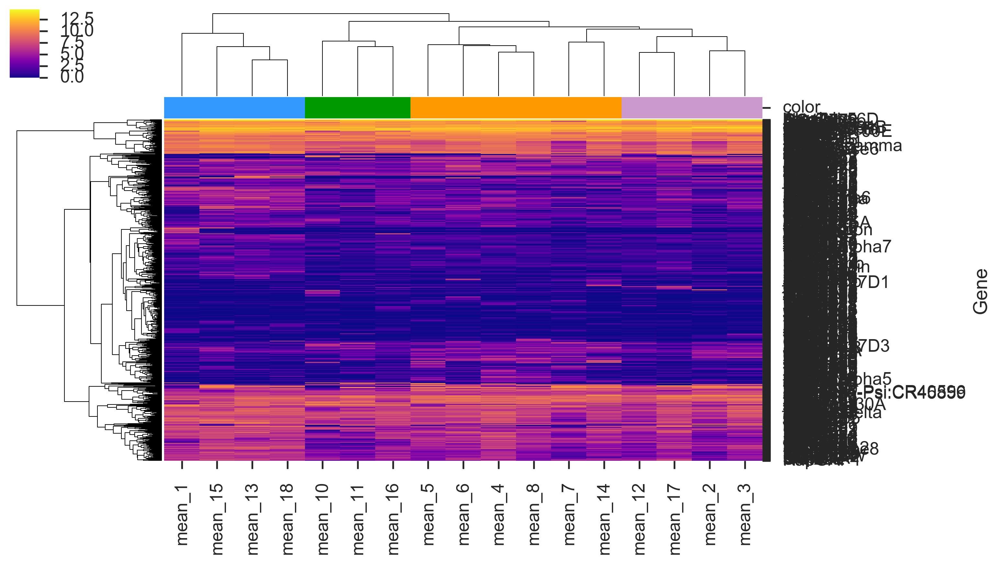

In [77]:
# Calculate clustering and plot
col_colors = df_libs.loc[Z.columns]["color"]
# cm = sns.clustermap(Z, metric="correlation", method="average", cmap="magma", figsize=(12,4), col_colors=col_colors)
cm = sns.clustermap(Z, method="complete", cmap="plasma", figsize=(10,6), row_cluster=True, col_cluster=True,col_colors=col_colors)

#cm.tick_params(top=True, bottom=False,labeltop=True, labelbottom=False)

plt.setp(cm.ax_heatmap.xaxis.get_majorticklabels(), rotation=90)
plt.setp(cm.ax_heatmap.yaxis.get_majorticklabels(), rotation=0)

cm.ax_heatmap.set_ylabel("Gene")
#cm.ax_heatmap.set_xticks([])
#cm.ax_heatmap.set_xticklabels([])
cm.savefig("../Figure/Fig_2_lineage/FigS3_heatmap_decoded.pdf")

In [80]:
Z = df_mean_decoded_new_no9_19_20.loc[DE_genes_combined_remove_dup]
Z.shape

(718, 19)

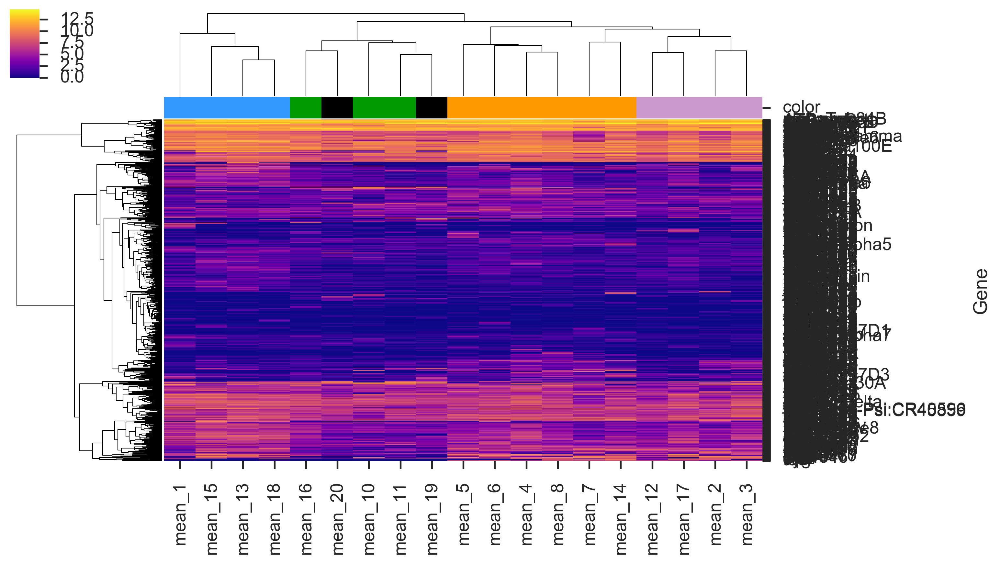

In [81]:
# Calculate clustering and plot
col_colors = df_libs.loc[Z.columns]["color"]
# cm = sns.clustermap(Z, metric="correlation", method="average", cmap="magma", figsize=(12,4), col_colors=col_colors)
cm = sns.clustermap(Z, method="complete", cmap="plasma", figsize=(10,6), row_cluster=True, col_cluster=True,col_colors=col_colors)

#cm.tick_params(top=True, bottom=False,labeltop=True, labelbottom=False)

plt.setp(cm.ax_heatmap.xaxis.get_majorticklabels(), rotation=90)
plt.setp(cm.ax_heatmap.yaxis.get_majorticklabels(), rotation=0)

cm.ax_heatmap.set_ylabel("Gene")
#cm.ax_heatmap.set_xticks([])
#cm.ax_heatmap.set_xticklabels([])
cm.savefig("../Figure/Fig_2_lineage/FigS3_heatmap_decoded_no9_19_20.pdf")

# Distance between four antennal typea

In [82]:
df_LB= df[list([x for x in list(names_LB_ORNs) if x not in list(name_cluster9)])]
df_TSB= df[names_SB_ORNs]
df_AT= df[names_TC_ORNs]
df_AC= df[names_AC_ORNs]

print df_LB.shape
print df_TSB.shape
print df_AT.shape
print df_AC.shape

(15908, 134)
(15908, 87)
(15908, 221)
(15908, 74)


In [83]:
df_LB['mean_LB'] = df_LB.mean(numeric_only=True, axis=1)
df_LB['mean_TSB'] = df_TSB.mean(numeric_only=True, axis=1)
df_LB['mean_AT'] = df_AT.mean(numeric_only=True, axis=1)
df_LB['mean_AC'] = df_AC.mean(numeric_only=True, axis=1)

In [84]:
df_LB.shape
df_type_mean = df_LB.iloc[:,134:138]
df_type_mean.shape

(15908, 4)

In [85]:
Z = df_type_mean.loc[DE_genes_combined_remove_dup]
Z.shape

(718, 4)

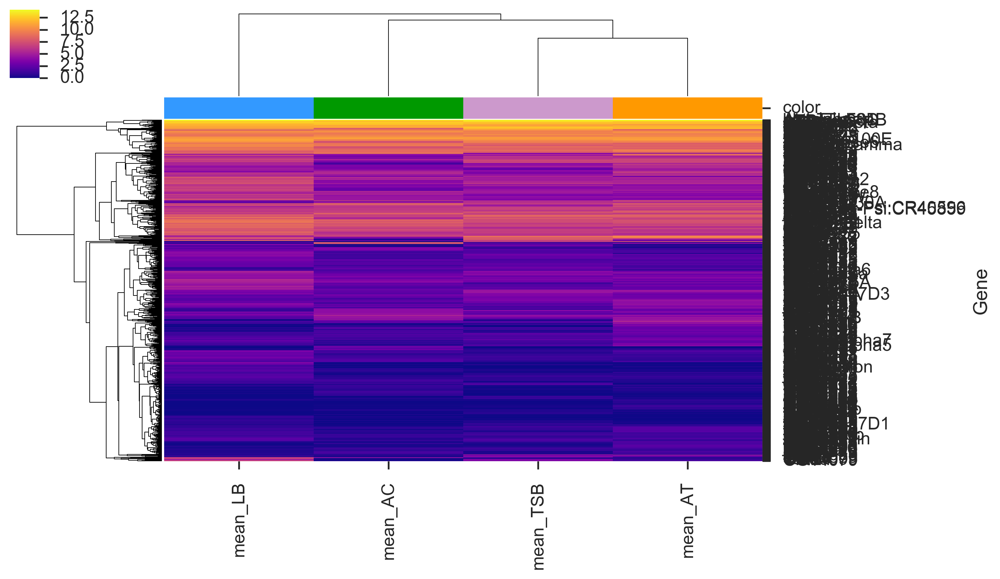

In [86]:
# Calculate clustering and plot
col_colors = df_libs.loc[Z.columns]["color"]
# cm = sns.clustermap(Z, metric="correlation", method="average", cmap="magma", figsize=(12,4), col_colors=col_colors)
cm = sns.clustermap(Z, method="average", cmap="plasma", figsize=(10,6), row_cluster=True, col_cluster=True, col_colors=col_colors)

#cm.tick_params(top=True, bottom=False,labeltop=True, labelbottom=False)

plt.setp(cm.ax_heatmap.xaxis.get_majorticklabels(), rotation=90)
plt.setp(cm.ax_heatmap.yaxis.get_majorticklabels(), rotation=0)

cm.ax_heatmap.set_ylabel("Gene")
#cm.ax_heatmap.set_xticks([])
#cm.ax_heatmap.set_xticklabels([])
cm.savefig("../Figure/Fig_2_lineage/FigS3_heatmap_four_Antennal_types.pdf")